# Homework 04

### Brown University  
### DATA 1010  
### Fall 2020

In [ ]:
using Random
using StatsBase

## Problem 1

For the function $f(x) = x^2$, apply gradient descent with the starting point $x_0 = 4$. 

(a) For which learning rate would the second step having length zero? For which learning rate would the *third* step be the first length-zero step?

(b) For which learning rates does the sequence of iterates never visit the ray $\{x \in \mathbb{R} \,:\, x < 0\}$?

(c) For which learning rates does the sequence of iterates diverge to $\pm\infty$?


### Solution

For the function $f(x) = x^2$, $f'(x) = 2x$. Therefore when applying a gradient descent problem, $x_{n + 1} = x_n - \epsilon * 2x_n = (1 - 2\epsilon) x_n$. Which means $x_{n} = (1 - 2\epsilon)^n x_0$, where $x_0 = 4$

(a) If we would want the second step to be zero, the derivative at the second point would be zero, which would mean $x_1 = (1 - 2\epsilon)x_0 = 0$, so $\epsilon = \frac{1}{2}$.  
From this equation, we know that it would be impossible for the third step to be the first non-zero length step.

(b) If we would like $x_n > 0$ for any $n$, this would mean that $(1 - 2\epsilon)^n > 0$ for any $n$, which would in turn mean $\epsilon \leq \frac{1}{2}$. Given the practicality of the learning rate, we would want $0 < \epsilon \leq \frac{1}{2}$

(c) As long as $|1 - 2\epsilon| > 1$, the final result will diverge to $\pm\infty$. This translates to $\epsilon < 0$ or $\epsilon > 1$. Again, considering the practicality of $\epsilon$ in that it should always be positive, we conclude that $\epsilon > 1$.

## Problem 2

Define function $f, \mathbb{R}^3 \rightarrow \mathbb{R}^1$ as:
$$
f(x, y) = \sin(x) + \sin(y) + \frac{x^2 + y^2}{10}
$$

(a) Use the code below to graph $f$. How many local minima do you see? Just from looking at the plot, where is the global minima (just a very rough estimate)?

<center><img src="surface-plot.png" width="300"></img></center>
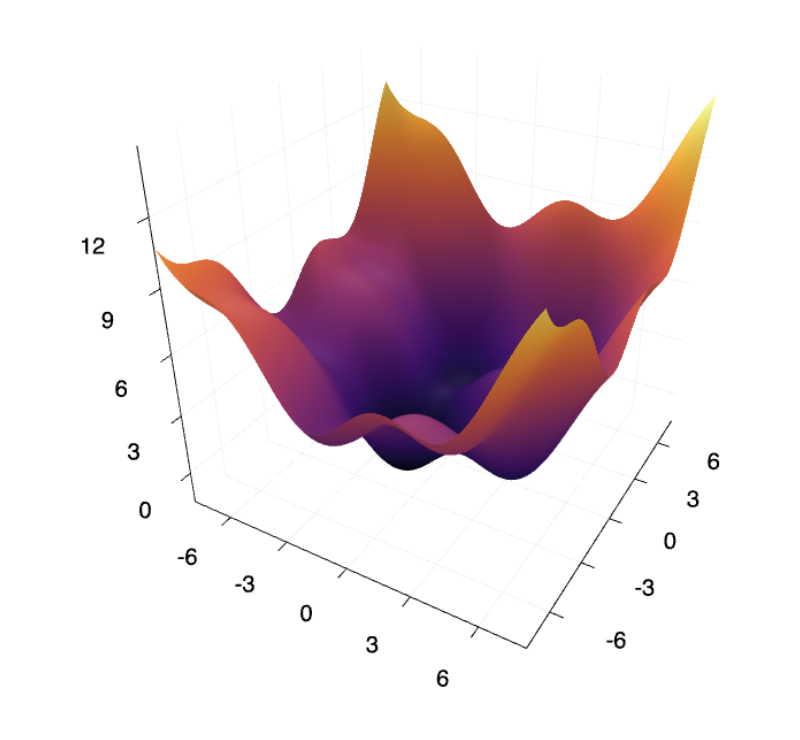

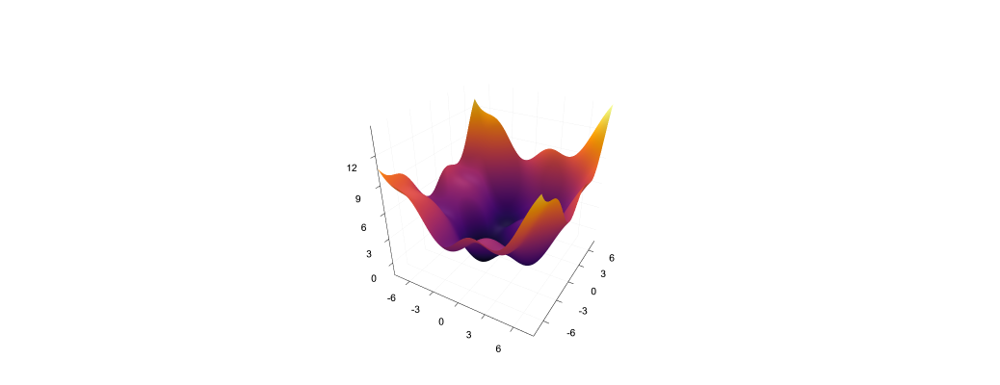

In [1]:
using Plots
plotlyjs()
f(x,y) = sin(x) + sin(y) + (x^2 + y^2)/10
surface(-8:0.05:8, -8:0.05:8, f)

(b) Implement a vanilla gradient descent method with a tunable learning rate $\epsilon$. Run that method on this surface with multiple starting points as well as learning rates. Plot the trajectories of your gradient descent on the surface. Do all of your trajectories end up in the global minima?

Here's some code showing how to add paths and points to the plot (the actual points having nothing to do with the problem). 

(c) Make a two-dimensional plot which colors each point according to which local minimum the gradient descent algorithm started at that point settles in. Try doing this for a few different learning rates, and comment on any interesting observations you make. 

*Hint: You don't have to do this entirely from scratch; it's done for a different function (though just for a single learning rate) in the Day-8 pre-class video.*

(d) Starting from a point pretty close to the global minimum, apply Newton's method (which we discussed in class), replacing $-\epsilon I$ in the gradient descent formula with $-H^{-1}$. Investigate whether this method converges faster. 

You can compute the Hessian either using automatic differentiation or symbolically, as you prefer.


(a) It looks that there are four local minima. Just eyeballing, the global minima seems to be somewhere around (-1, -1) (It's perfectly okay if your answer is not exactly this, in fact your guess could be closer).

(b) 

In [2]:
using ForwardDiff

function grad_desc(f, p, e=0.01, thres=1e-8, max_iter = 500)
    # f is a function, p an array representing the starting point, and e the learning rate.
    # Applies vanilla gradient descent with thres as stopping threshold.
    cur_grad = [1, 1]
    cur_point = p
    trajectory = []
    count = 0
    while norm(cur_grad) > thres
        count = count + 1
        if count > max_iter
            return trajectory
        end
        cur_grad = ForwardDiff.gradient(f, cur_point)
        cur_point = cur_point - cur_grad * e
        push!(trajectory, cur_point)
    end
    return trajectory
end
    

grad_desc (generic function with 4 methods)

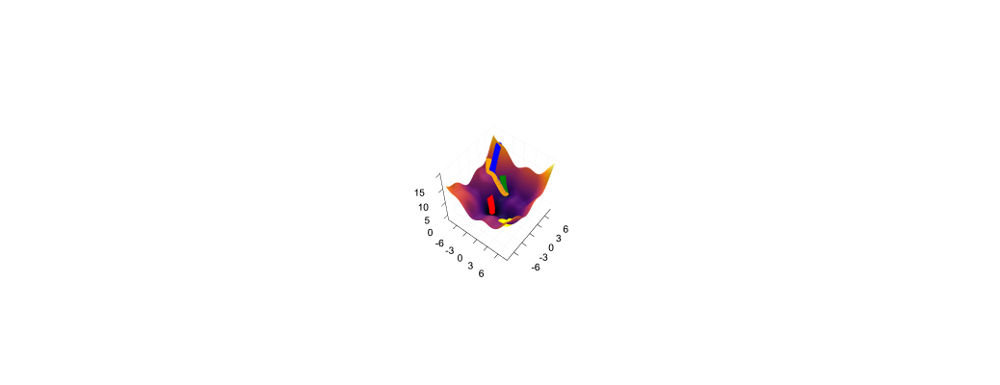

In [3]:

using Plots
using Random

Random.seed!(45)

plotlyjs(legend = false)
f(x) = sin(x[1]) + sin(x[2]) + (x[1]^2 + x[2]^2)/10

plt = surface(-8:0.05:8, -8:0.05:8, f)

for (_, c) in zip(1:5, ["red", "green", "blue", "yellow", "orange"])
    s = grad_desc(f, [rand() * 16 - 8, rand() * 16 - 8], 0.1)
    points = [(i[1], i[2], f(i) + 0.1) for i in s]
    path3d!(points, linewidth=5, c=c)
    scatter3d!(points, markersize=2, c=c, msw=0)
end

Plots.display(plt)


No, they do not all end up in the global minima.

(c)

For a relatively small learning rate, things are quite benign:

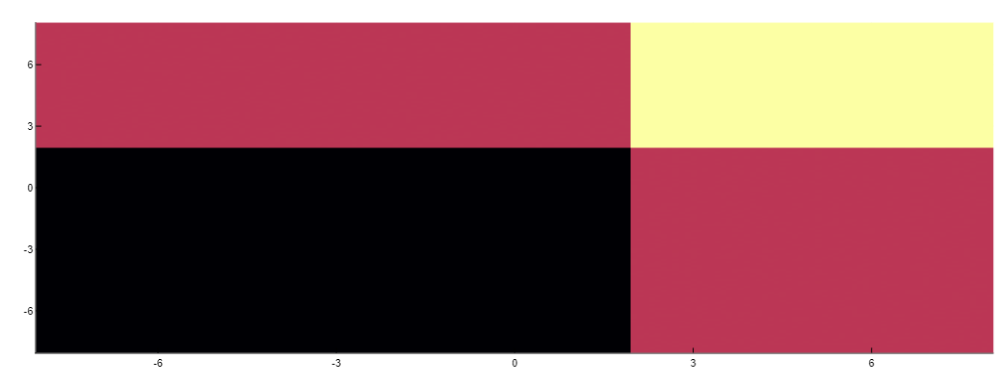

In [4]:

plotlyjs()
heatmap(-8:0.1:8, -8:0.1:8, (x, y) -> f(grad_desc(f, [x, y], 0.1, 1e-8)[end]))


However it becomes very strange when the learning rate is too large, this is due to the point resonating around the local minima.

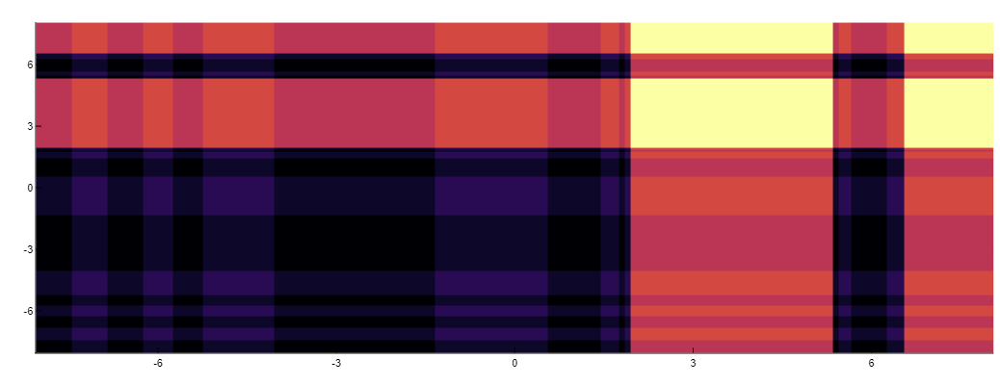

In [5]:

plotlyjs()
heatmap(-8:0.1:8, -8:0.1:8, (x, y) -> f(grad_desc(f, [x, y], 2, 1e-8)[end]))


We put the first case above the original heatmap and find that it makes sense.

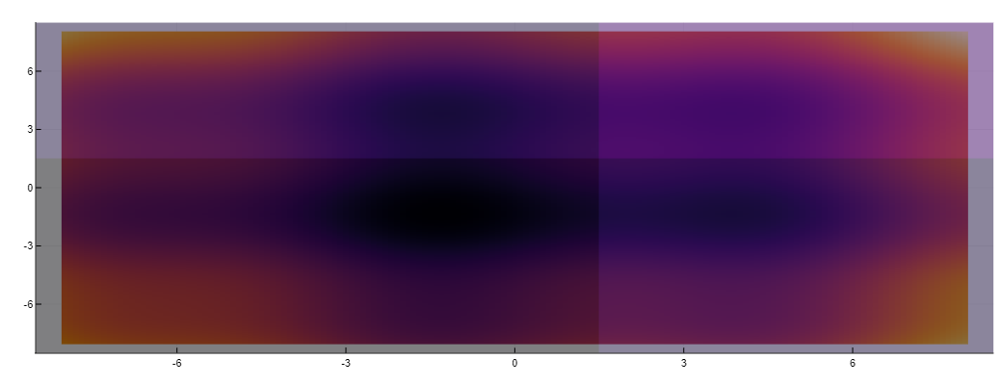

In [6]:

heatmap(-8:0.1:8, -8:0.1:8, (x, y) -> f([x, y]), alpha=1)
heatmap!(-8:1:8, -8:1:8, (x, y) -> f(grad_desc(f, [x, y], 0.1, 1e-8)[end]), alpha=0.5)

In [7]:
using ForwardDiff

function newt_desc(f, p, e=0.01, thres=1e-8, max_iter = 500)
    # f is a function, p an array representing the starting point, and e the learning rate.
    # Applies vanilla gradient descent with thres as stopping threshold.
    cur_grad = [1, 1]
    cur_point = p
    trajectory = []
    count = 0
    while norm(cur_grad) > thres
        count = count + 1
        if count > max_iter
            return trajectory
        end
        cur_grad = ForwardDiff.gradient(f, cur_point)
        cur_point = cur_point - ForwardDiff.hessian(f, cur_point) * cur_grad
        push!(trajectory, cur_point)
    end
    return trajectory
end

newt_desc (generic function with 4 methods)

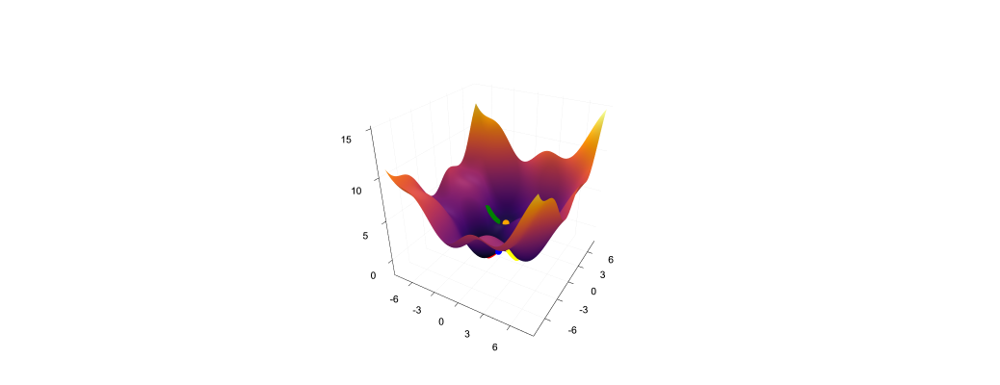

In [8]:
plt = surface(-8:0.05:8, -8:0.05:8, f)

for (_, c) in zip(1:5, ["red", "green", "blue", "yellow", "orange"])
    s = newt_desc(f, [rand() * 8 - 4, rand() * 8 - 4], 0.002)
    points = [(i[1], i[2], f(i) + 0.1) for i in s]
    path3d!(points, linewidth=5, c=c)
    scatter3d!(points, markersize=2, c=c, msw=0)
end

Plots.display(plt)


Yes, this takes a learning rate of much smaller to converge with reasonable speed.

## Problem 3

Consider a 100-person queue at a theatre, with each person in the queue having their own designated seat in a theatre which has 5 rows and 25 seats per row (so there will be 25 empty seats).

(a) If all of them were to be seated randomly (each choice being made uniformly at random from the empty seats, independently from previous choices), what is the expected number of people who end up in their designated seats?

(b) Initially, there are $17, 19, 21, 23, 20$ seats assigned in each row, respectively. If every person were to be seated randomly, what is the expected number of people who end up in their originally designated row?

(c) The first person to enter lost his seat number and decides to choose their seat randomly. Every other person who enters follows the rules below:

- If their designated seat is not already taken, they will take that seat.
- If their designated seat is already taken, they will choose a seat randomly.

Use Julia to sample 100,000 instances of this experiment and thereby approximate (i) the probability that the last person in line will end up in his/her own seat, and (ii) the number of people who end up in their own seat. 

It might also be interesting to look at the some sample plots of the number of people who get to take their own seat by the time the $n$th person sits, as a function of $n$ (this part is optional). 


### Solution

(a) Due to the linearity of expectation:  
$$
E\left[\sum^n_{i=1}X_i\right] = \sum^n_{i=1}E\left[X_i\right] = \frac{1}{125} \cdot 100 = 0.8
$$
Which is to say, the expectation of number of people ending up on their own seats is $0.8$.

(b) Again due to the linearity of expectation:
$$
E\left[\sum^n_{i=1}X_i\right] = \sum^n_{i=1}E[X_i] = \frac{1}{5} \cdot 100 = 20
$$
Which is to say, the expectation of number of people ending up in their own rows is $20$.

(c)

In [9]:

function experiment()
    
    a = [0 for _ in 1:125]
    a[sample(1:125)] = 1
    count = 0
    for n in 2:99
    
        if (a[n] == 0)
            a[n] = 1
            count += 1
        else
            s = sample(1:125)
            while a[s] != 0
                s = sample(1:125)
            end
            a[s] = 1
        end
    end
#     print(sum(a))
    if a[100] == 0
        return 1, count
    else
        return 0, count
    end
end


experiment (generic function with 1 method)

In [10]:
results = [experiment() for _ in 1:1e+5]
println(mean([a[1] for a in results]))
println(mean([a[2] for a in results]))

0.9626
96.48254



So about $96\%$ of the time the last person ends up in their seat, also around $96\%$ of people end up in their own seats. Not surprising, as we do expect these two numbers to be similar.

## Problem 4

Suppose we sample two independent random variables, $X_1$ and $X_2$, from the uniform distribution $\mathrm{Uniform}(0, 1)$.

(a) Explain briefly why this method is equivalent to uniformly sampling a point from the unit square $\{(a, b)\ |\ 0 \leq a \leq 1, 0 \leq b \leq 1\}$, and assigning $a$ to $x_1$ and $b$ to $x_2$. You will need to use mathematical expressions where necessary.

(b) What is the expected value and variance of $|X_1 - X_2|$?

(c) Let $Y_1 = \min(X_1, X_2)$ and $Y_1 = \max(X_1, X_2)$. What is the expected value of $Y_1$. What's the expected value of $Y_2$ What is the difference between these two expected values?

(d) Suppose we are now sampling **three** independent numbers from $\mathrm{Uniform}(0, 1)$. What is the expected value of the smallest number of the three? As an optional addition, generalize your reasoning from 3 to an arbitrary positive integer $n$. 


### Solution

(a) When sampling from a unit square, the joint distribution function of $X_1$ and $X_2$ is $f(X_1, X_2) = 1$. From this, we conclude that the conditional distribution functions for both $X_1$ and $X_2$ are both $\mathrm{Uniform}(0, 1)$. Also, for any given $X_1 = X_1^0$, the distribution for $X_2$ follows $\mathrm{Uniform}(0, 1)$, this holds in the opposite direction as well. Therefore this sampling method will generate the exact same results as sampling $X_1$ and $X_2$ both independently fron $\mathrm{Uniform}(0, 1)$.

(b) 
$$
E(|X_1 - X_2|) = \iint_{0 \leq X_1, X_2 \leq 1} |X_1 - X_2| dX_1dX_2 = \iint_{0 \leq X_1 \leq X_2 \leq 1} (X_1 - X_2) dX_1dX_2 + \iint_{0 \leq X_2 < X_1 \leq 1} (X_2 - X_1) dX_1dX_2 = \frac{1}{3}
$$
$$
Var(|X_1 - X_2|) = \iint_{0 \leq X_1, X_2 \leq 1} |X_1 - X_2|^2 dX_1dX_2 = \iint_{0 \leq X_1, X_2 \leq 1} (X_1 - X_2)^2 dX_1dX_2
$$

(c)
$$
E(min(X_1, X_2)) = \iint_{0 \leq X_1 \leq X_2 \leq 1} X_1 dX_1dX_2 + \iint_{0 \leq X_2 < X_1 \leq 1} X_2 dX_1dX_2 = \int_0^1 \int_0^{X_2} X_1 dX_1dX_2 + \int_0^1 \int_0^{X_1} X_2 dX_2dX_1 = \frac{1}{6} + \frac{1}{6} = \frac{1}{3}
$$
$$
E(max(X_1, X_2)) = \iint_{0 \leq X_1 \leq X_2 \leq 1} X_2 dX_1dX_2 + \iint_{0 \leq X_2 < X_1 \leq 1} X_1 dX_1dX_2 = \int_0^1 \int_0^{X_2} X_2 dX_1dX_2 + \int_0^1 \int_0^{X_1} X_1 dX_2dX_1 = \frac{1}{3} + \frac{1}{3} = \frac{2}{3}
$$

The difference between these two is $\frac{1}{3}$, which is exactly the expectation of the absolute value of the difference.

(d) 

If we are sampling three numbers, we simply add a term to the integral and discuss the different possibilities of the size ranking of $X_1, X_2$, and $X_3$.
$$
E(min(X_1, X_2, X_3)) = \iint_{0 \leq X_1 \leq X_2, X_3 \leq 1} X_1 dX_1dX_2 + \iint_{0 \leq X_2 \leq X_1, X_3 \leq 1} X_2 dX_1dX_2 + \iint_{0 \leq X_3 \leq X_1, X_2 \leq 1} X_3 dX_1dX_2 = \int_0^1 \int_{X_1}^1 \int_{X_1}^1 X_1 dX_1dX_2dX_3 + \int_0^1 \int_{X_2}^1 \int_{X_2}^1 X_2 dX_2dX_1dX_3 + \int_0^1 \int_{X_3}^1 \int_{X_3}^1 X_3 dX_3dX_1dX_2 = \frac{1}{12} + \frac{1}{12} + \frac{1}{12} = \frac{1}{4}
$$
Here we note that the overlapping sections are infinitesimally small and will not contribute to the result.  
It can be extrapolated (not very obviously) that for $n$ samples the average should be $\frac{1}{n + 1}$. However, it is a lot more obvious that as $n$ gets extremely large the result should be zero, as it is almost guaranteed that at least one of those points will be extremely close to zero.

Also note that there is a much more elegant way of solving this problem by first finding the CDF, and then taking the derivative of that to obtain the PDF.

## Problem 5

Consider a random independent sequence of letters, with each letter uniformly distributed in {a, b, . . . , z}. Use simulation to estimate the expected number of letters that appear in the sequence up to the first appearance of aa. Repeat with ab in place of aa. Based on your findings, is the expected time to the first aa different from the expected time to the first ab?


### Solution

In [11]:
s = ""
count = 0

function run_once(str)
    p = ""
    count = 0
    while count < 10000
        count += 1
        s = sample('a':'z')
        if (p * s == str)
            return count
        end
        p = s
    end
    return count
end
println(mean([run_once("aa") for _ in 1:100000]))
println(mean([run_once("ab") for _ in 1:100000]))

700.45967
672.47186



The mean time of getting the first `aa` is a bit over $700$ letters, while the first `ab` is just under $680$. This is because of a small imbalance when we hit an `a` in both scenarios. If when we are looking for `aa`, and the letter following the first `a` is `b`, there is no chance that the run will end on the next letter. However, if we were looking for `ab` and the letter following the first `a` is another `a`, there is a $\frac{1}{26}$ chance of it ending on the next run. This detail makes up this difference in expectation.